<h1>Содержание<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Подготовка-данных" data-toc-modified-id="Подготовка-данных-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Подготовка данных</a></span><ul class="toc-item"><li><span><a href="#Изучение-данных" data-toc-modified-id="Изучение-данных-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Изучение данных</a></span></li><li><span><a href="#Проверка-эффективности-обогащения-чернового-концентрата-rougher.output.recovery-(MAE)" data-toc-modified-id="Проверка-эффективности-обогащения-чернового-концентрата-rougher.output.recovery-(MAE)-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Проверка эффективности обогащения чернового концентрата rougher.output.recovery (MAE)</a></span></li><li><span><a href="#Предобработка-данных" data-toc-modified-id="Предобработка-данных-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Предобработка данных</a></span></li></ul></li><li><span><a href="#Анализ-данных" data-toc-modified-id="Анализ-данных-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Анализ данных</a></span><ul class="toc-item"><li><span><a href="#Изменение-концентрации-металлов-(Au,-Ag,-Pb)-на-различных-этапах-очистки." data-toc-modified-id="Изменение-концентрации-металлов-(Au,-Ag,-Pb)-на-различных-этапах-очистки.-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Изменение концентрации металлов (Au, Ag, Pb) на различных этапах очистки.</a></span></li><li><span><a href="#Распределения-размеров-гранул-сырья-на-обучающей-и-тестовой-выборках" data-toc-modified-id="Распределения-размеров-гранул-сырья-на-обучающей-и-тестовой-выборках-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Распределения размеров гранул сырья на обучающей и тестовой выборках</a></span></li><li><span><a href="#Суммарная-концентрация-всех-веществ-на-разных-стадиях:-в-сырье,-в-черновом-и-финальном-концентратах." data-toc-modified-id="Суммарная-концентрация-всех-веществ-на-разных-стадиях:-в-сырье,-в-черновом-и-финальном-концентратах.-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Суммарная концентрация всех веществ на разных стадиях: в сырье, в черновом и финальном концентратах.</a></span></li></ul></li><li><span><a href="#Модель" data-toc-modified-id="Модель-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Модель</a></span><ul class="toc-item"><li><span><a href="#Функция-для-вычисления-итоговой-sMAPE" data-toc-modified-id="Функция-для-вычисления-итоговой-sMAPE-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Функция для вычисления итоговой sMAPE</a></span></li><li><span><a href="#Обучение-разных-моделей-и-оценка-их-качества-кросс-валидацией" data-toc-modified-id="Обучение-разных-моделей-и-оценка-их-качества-кросс-валидацией-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Обучение разных моделей и оценка их качества кросс-валидацией</a></span><ul class="toc-item"><li><span><a href="#Подбор-лучшей-модели" data-toc-modified-id="Подбор-лучшей-модели-3.2.1"><span class="toc-item-num">3.2.1&nbsp;&nbsp;</span>Подбор лучшей модели</a></span></li></ul></li></ul></li><li><span><a href="#Общий-вывод" data-toc-modified-id="Общий-вывод-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Общий вывод</a></span></li><li><span><a href="#Чек-лист-готовности-проекта" data-toc-modified-id="Чек-лист-готовности-проекта-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Чек-лист готовности проекта</a></span></li></ul></div>

# Восстановление золота из руды

**Задача:**

Подготовить прототип модели машинного обучения для прогнозирования коэффициента восстановления золота из золотосодержащей руды для оптимизации производства, чтобы не запускать предприятие с убыточными характеристиками.

**Данные:**

В распоряжении имеются данные с параметрами добычи и очистки.

> **Наименование признаков**
> 
> Наименование признаков строится по следующему правилу:
> 
> `[этап].[тип_параметра].[название_параметра]`
> 
> Пример: `rougher.input.feed_ag`
> 
> Возможные значения для блока `[этап]`:
> 
> - **rougher** — флотация
> - **primary_cleaner** — первичная очистка
> - **secondary_cleaner** — вторичная очистка
> - **final** — финальные характеристики
> 
> Возможные значения для блока `[тип_параметра]`:
> 
> - **input** — параметры сырья
> - **output** — параметры продукта
> - **state** — параметры, характеризующие текущее состояние этапа
> - **calculation** — расчётные характеристики 

## Подготовка данных

### Изучение данных

In [1]:
import pandas as pd
import sweetviz as sv
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import mean_absolute_error, make_scorer
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.dummy import DummyRegressor
from sklearn.model_selection import cross_val_score

In [2]:
df_train = pd.read_csv('gold_recovery_train_new.csv')
df_test = pd.read_csv('gold_recovery_test_new.csv')
df_full = pd.read_csv('gold_recovery_full_new.csv')

Создадим функцию для создания отчета по данным с помощью библиотеки `sweetviz`.

In [3]:
def sv_info_df(df):
    report = sv.analyze(df)
    report.show_notebook()

Отчет по данным в обучающей выборке.

                                             |          | [  0%]   00:00 -> (? left)


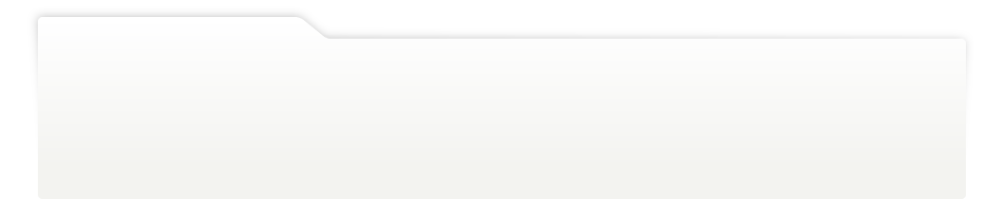
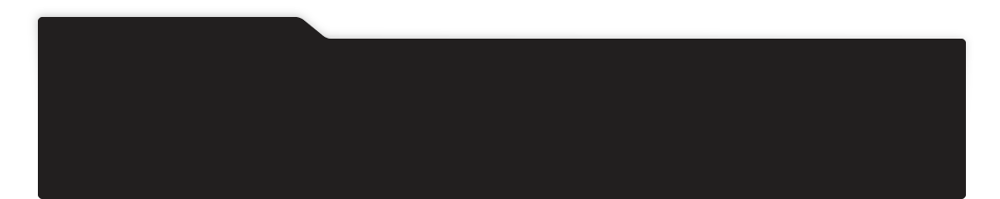
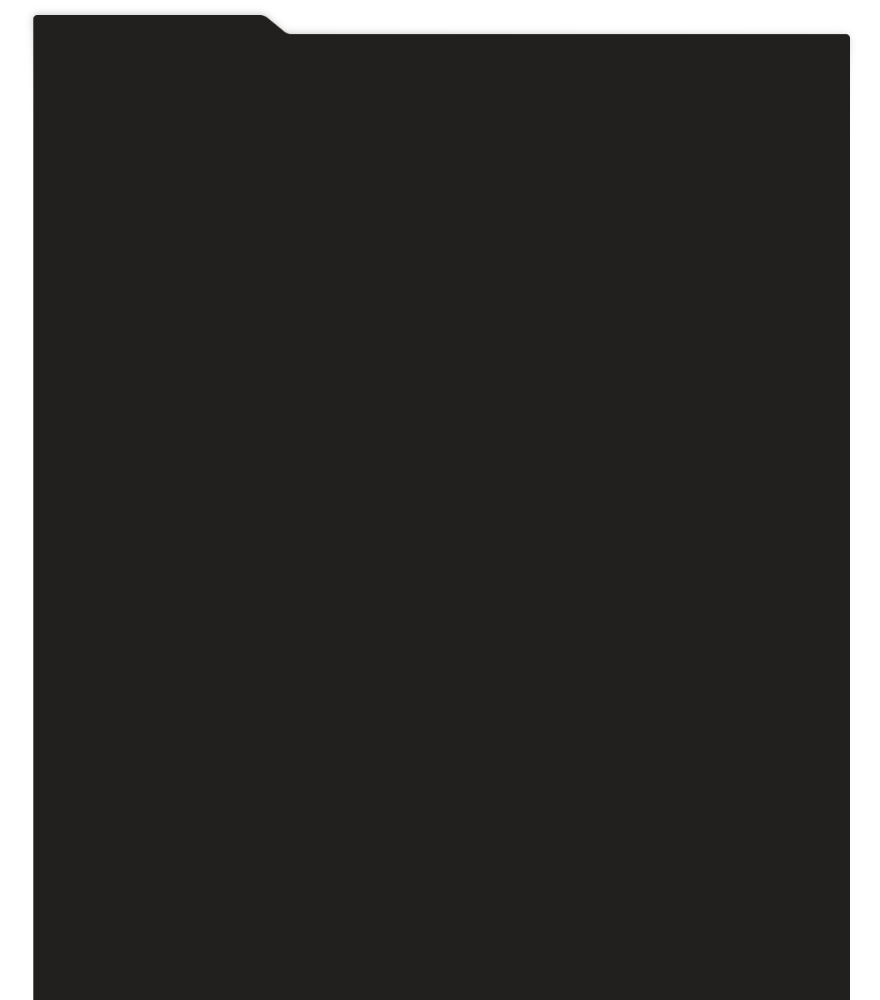
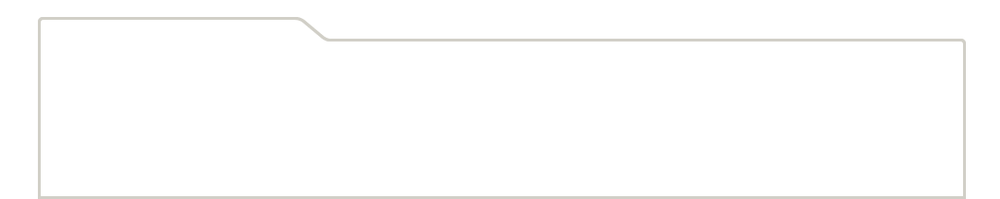
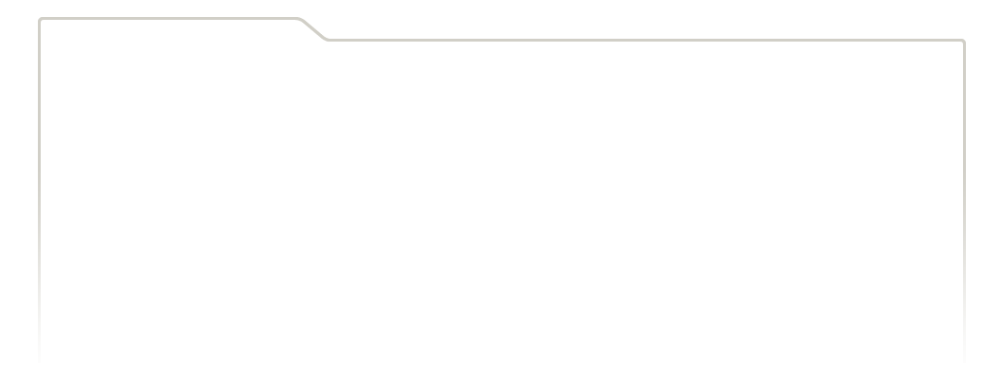
...
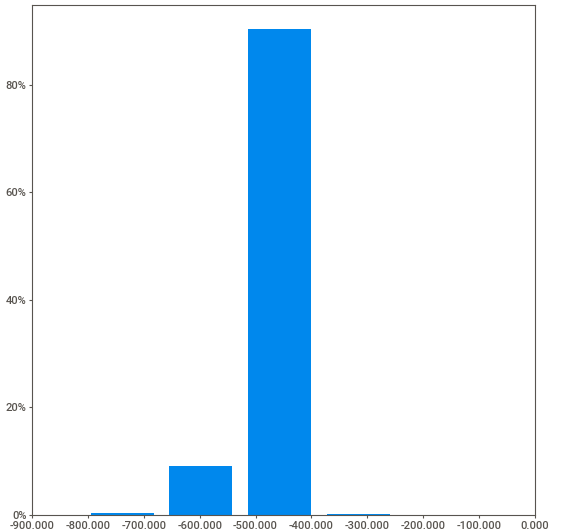
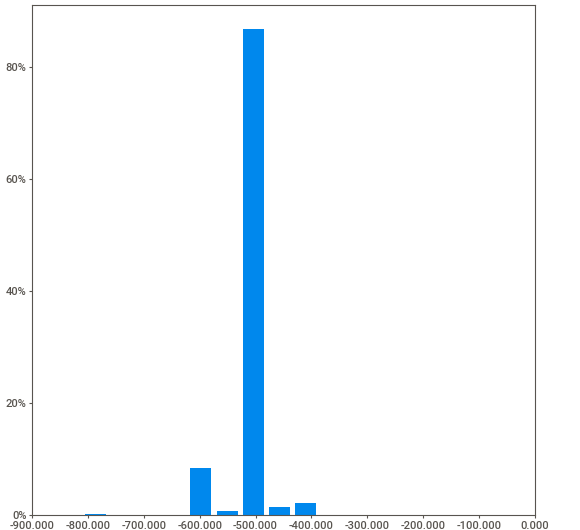
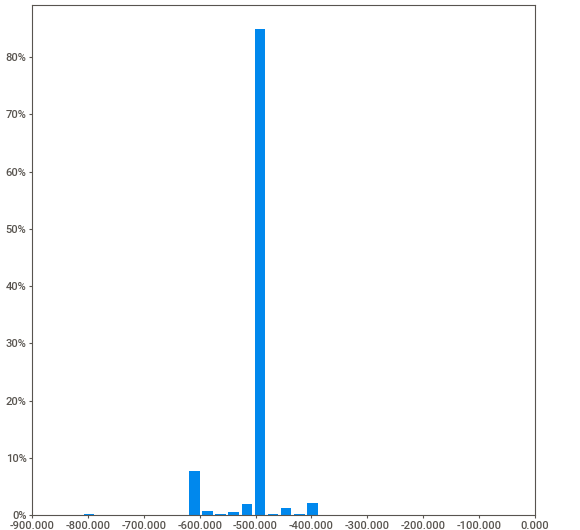
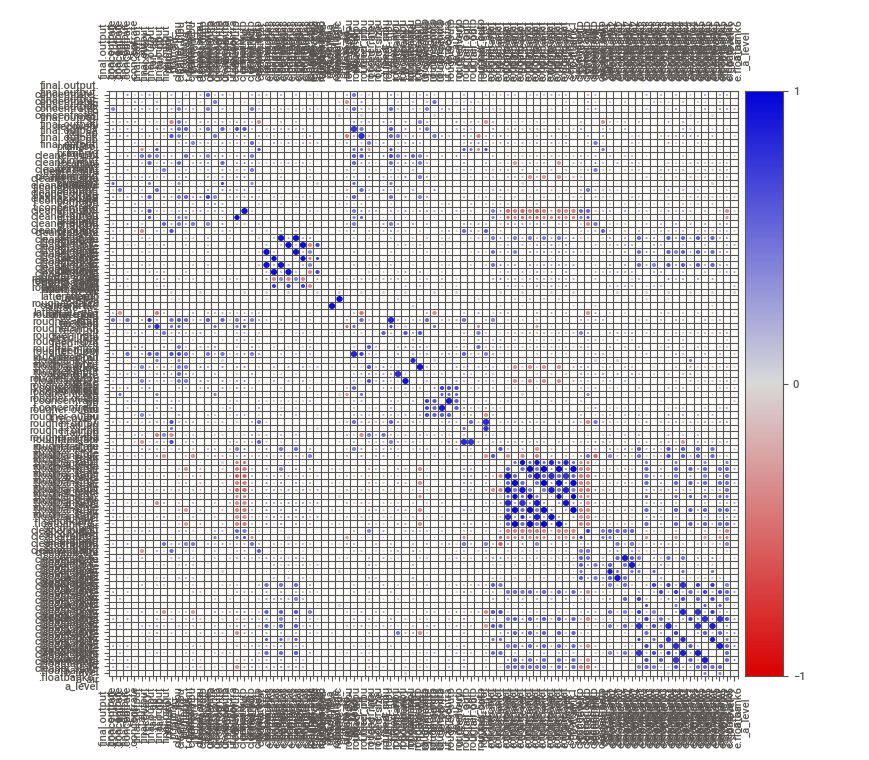
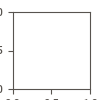

In [4]:
sv_info_df(df_train)

Отчет по данным в тестовой выборке.

                                             |          | [  0%]   00:00 -> (? left)


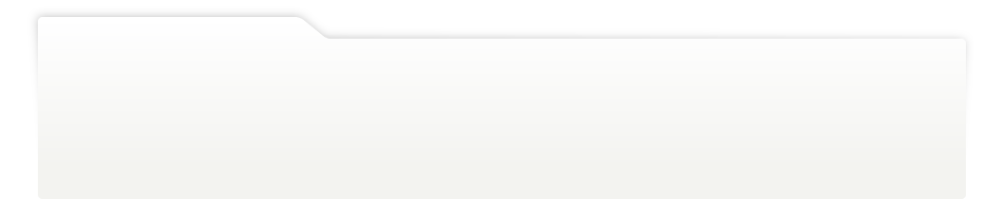
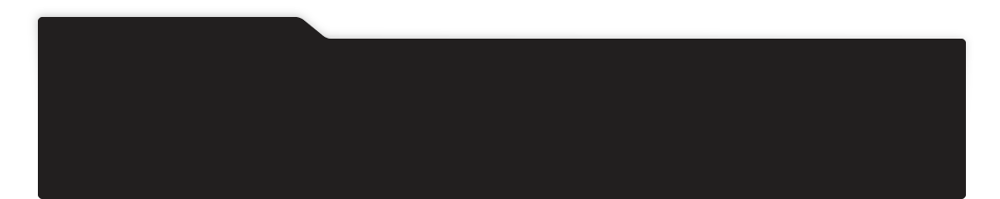
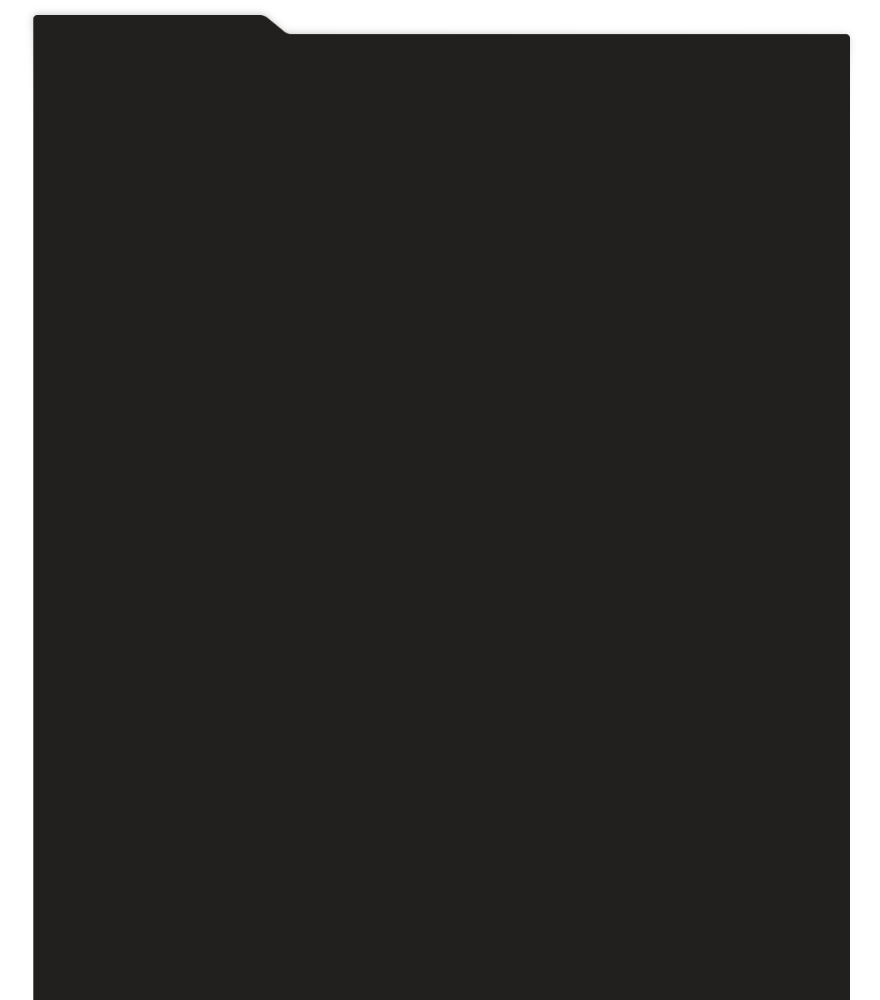
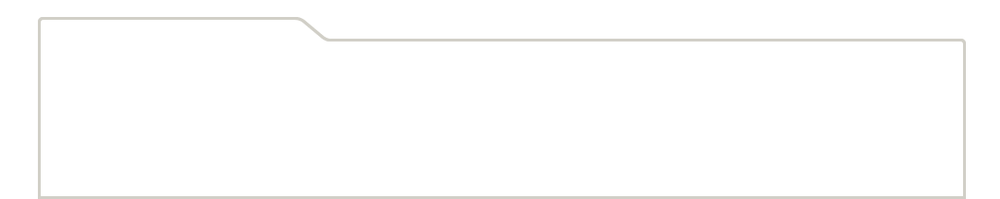
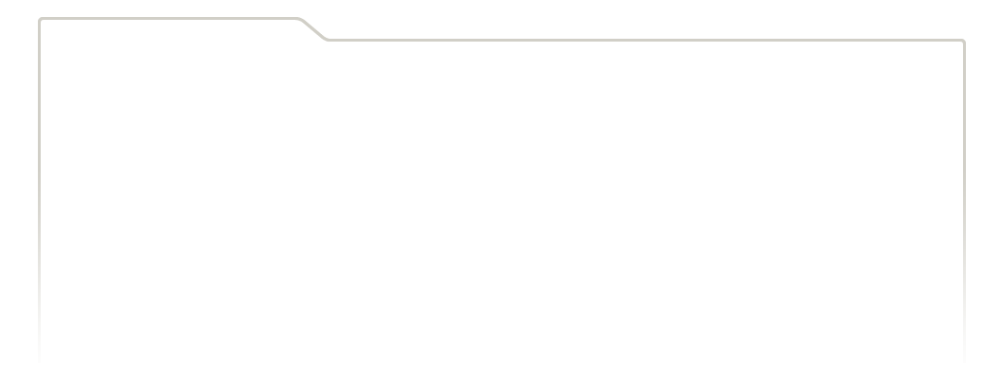
...
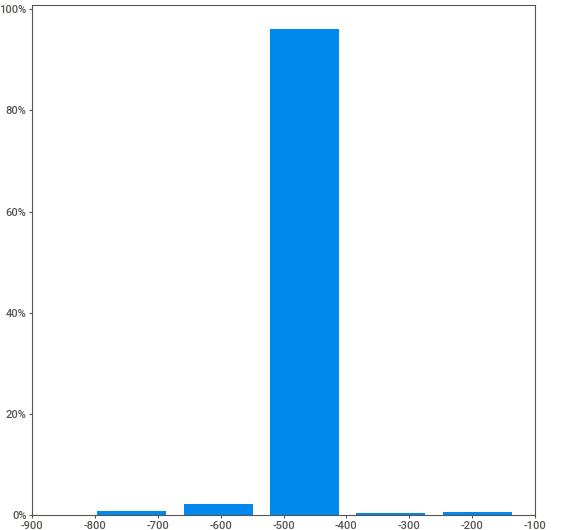
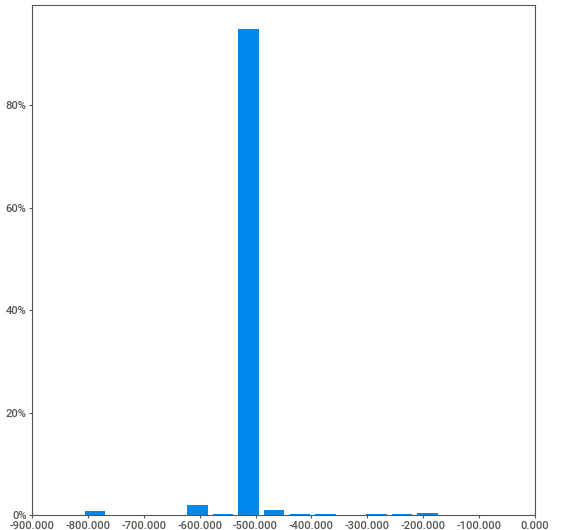
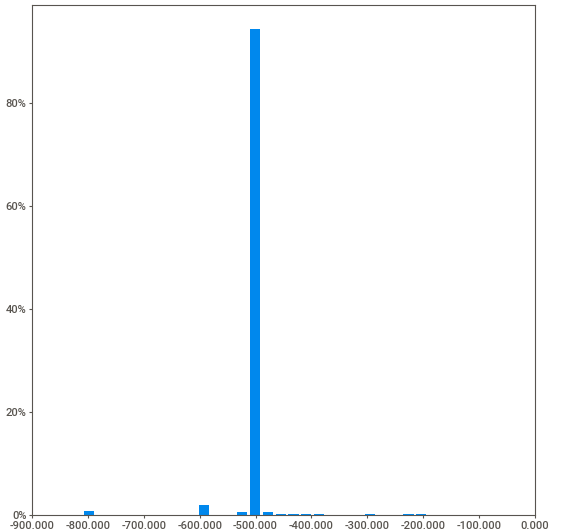
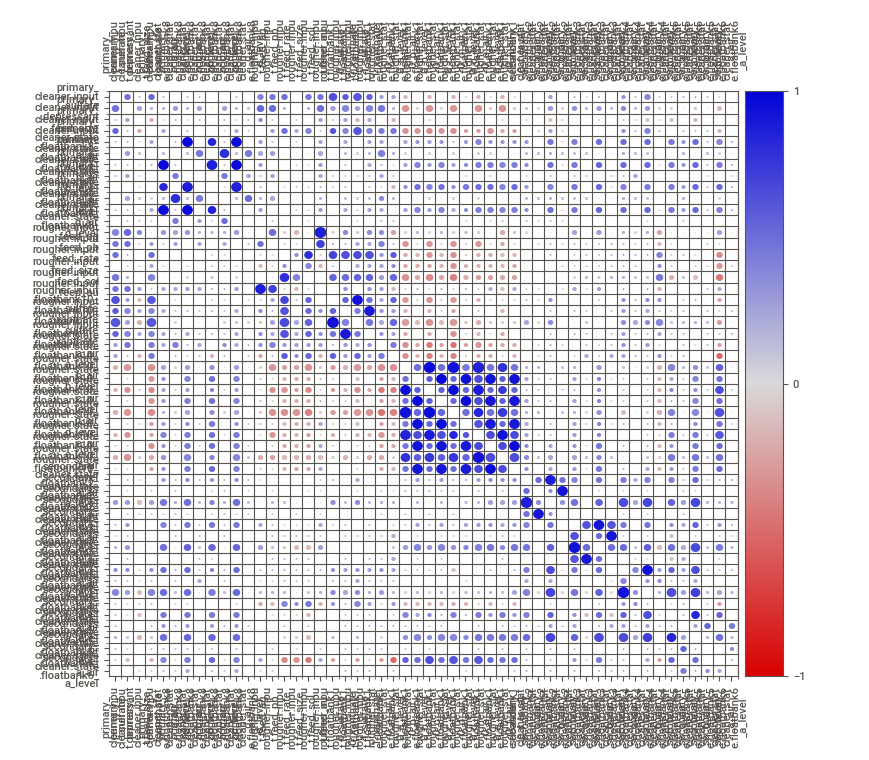
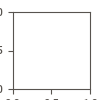

In [5]:
sv_info_df(df_test)

Отчет по исходным данным.

                                             |          | [  0%]   00:00 -> (? left)


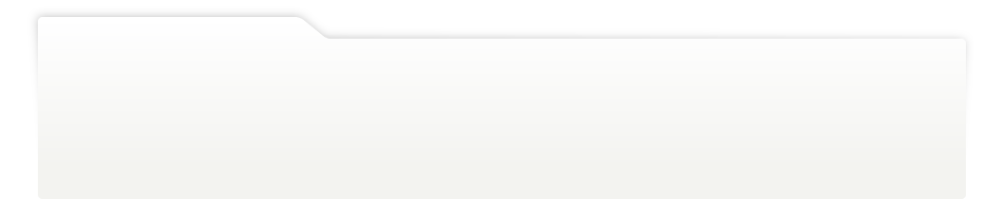
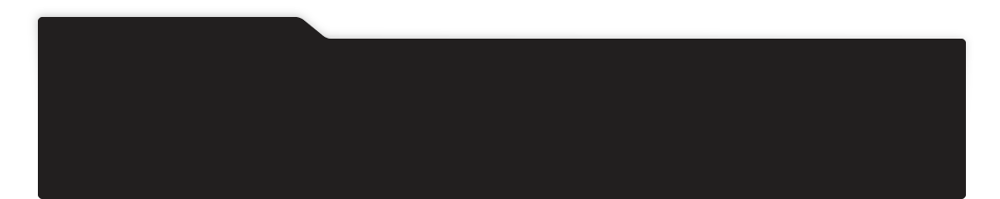
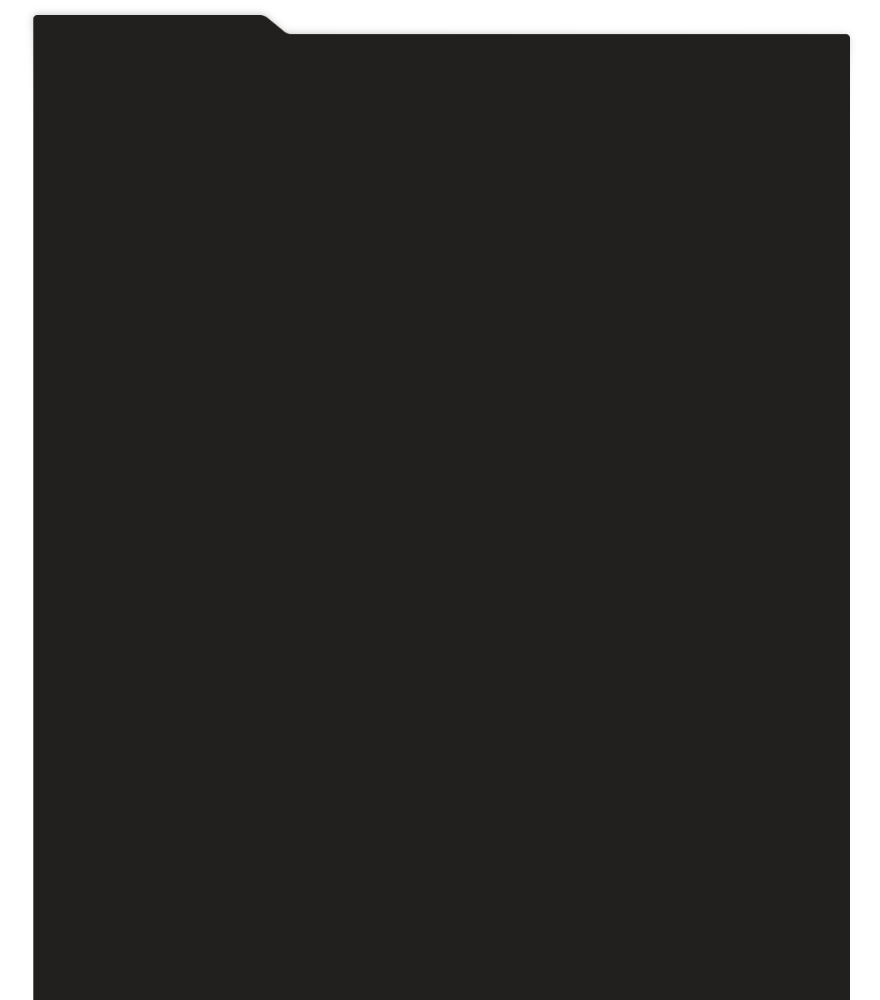
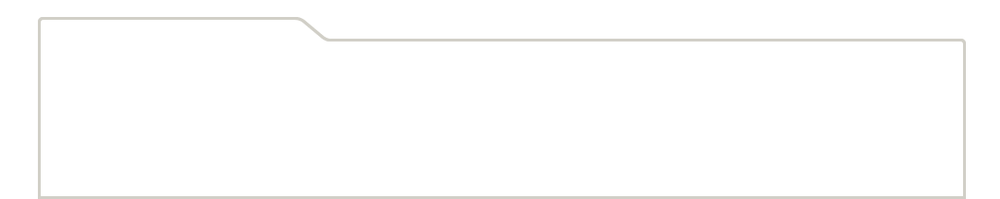
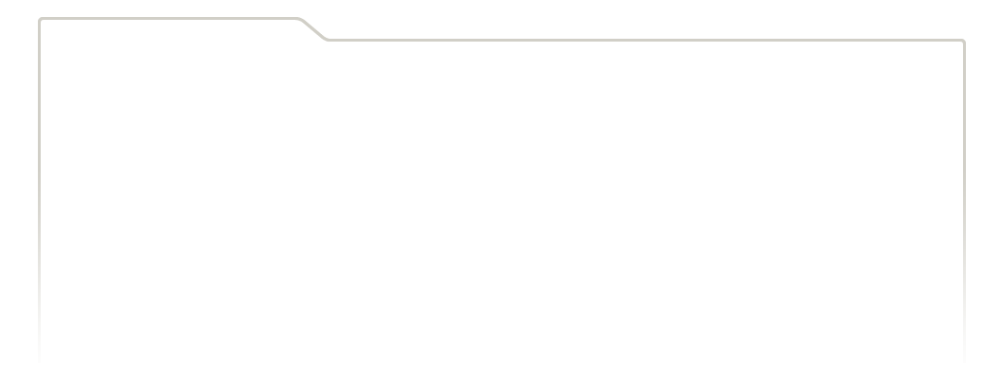
...
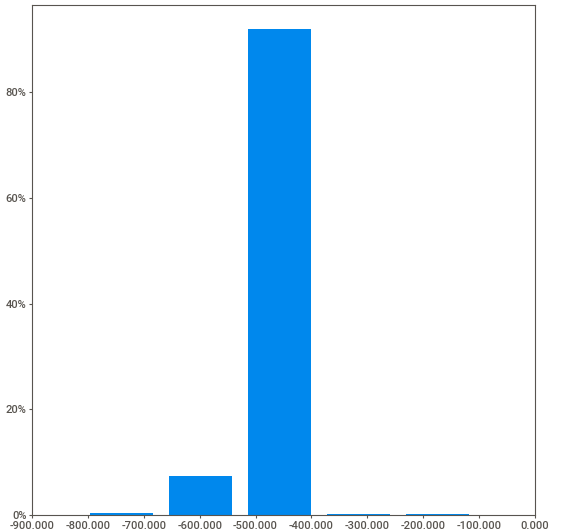
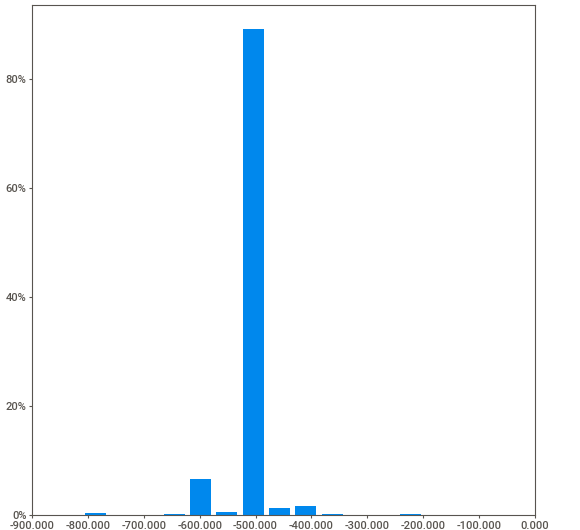
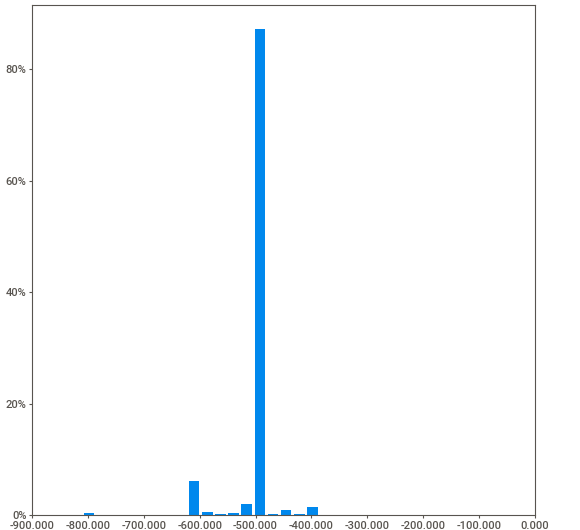
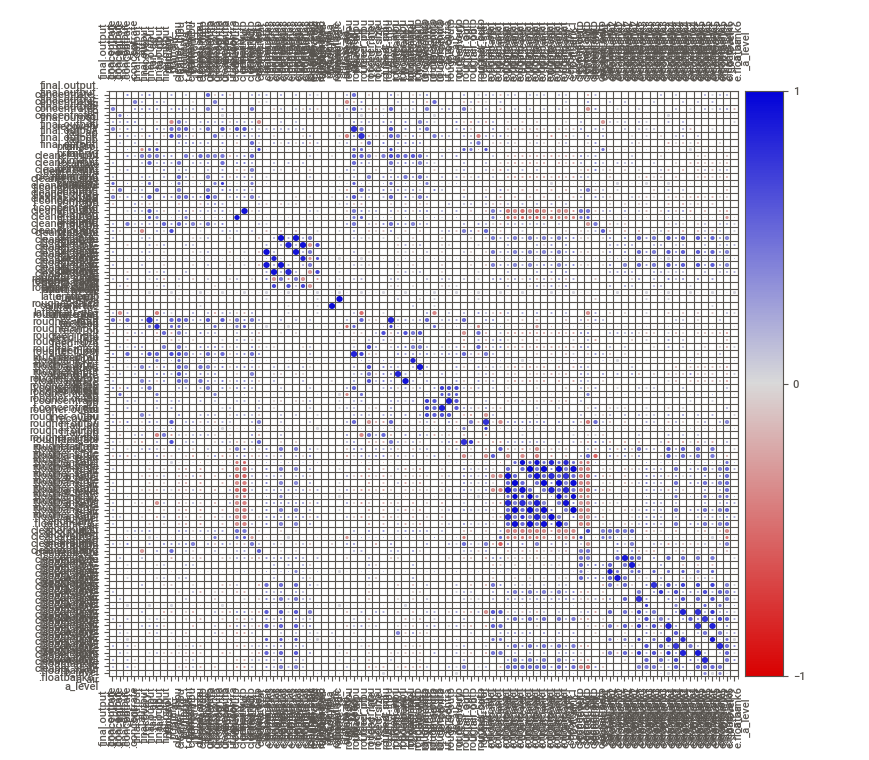
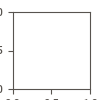

In [6]:
sv_info_df(df_full)

### Проверка эффективности обогащения чернового концентрата rougher.output.recovery (MAE)

Эффективность обогащения рассчитывается по следующей формуле:

$ Recovery = \frac{C*(F-T)}{F*(C-T)} * 100$ %

Где:
- C - доля золота в концентрате после флотации/очистки;
- F - доля золота в сырье/концентрате до флотации/очистки;
- T - доля золота в отвальных хвостах после флотации/очистки.

Для проверки эффективности необходимо заполнить пропуски в столбцах тестовой выборки. Так как _"Данные индексируются датой и временем получения информации (признак date). Соседние по времени параметры часто похожи."_, для заполнения данных можно воспользоваться методами `.ffill()`(предполагает, что мы берем предыдущее от пропущенного значение и заполняем им пропуск.)

Заполним пропуски в необходимых для расчетов столбцах.

In [7]:
ff_concentrate_au = df_train['rougher.output.concentrate_au'].ffill() #C
ff_tail_au = df_train['rougher.output.tail_au'].ffill() #T
ff_feed_au = df_train['rougher.input.feed_au'].ffill() #F
ff_recovery = df_train['rougher.output.recovery'].ffill() #Recovery

calculated_recovery = ((ff_concentrate_au * (ff_feed_au - ff_tail_au)) /
                       (ff_feed_au * (ff_concentrate_au-ff_tail_au))) * 100

print('Средняя абсолютная ошибка =',mean_absolute_error(ff_recovery, calculated_recovery))

Средняя абсолютная ошибка = 9.73512347450521e-15


Средняя абсолютная ошибка очень близка к нулю, значит эффективности обогащения по данным из столбца верная.

### Предобработка данных

Исходя из задания _"Некоторые параметры недоступны, потому что замеряются и/или рассчитываются значительно позже. Из-за этого в тестовой выборке отсутствуют некоторые признаки, которые могут быть в обучающей. Также в тестовом наборе нет целевых признаков."_ Скорее всего столбцы этапов rougher.output, rougher.calculation, final.output, primary_cleaner.output и secondary_cleaner.output отсутствуют в тестовой выборке, так как заполняются после технических процессов.

Выведем полный список недоступных признаков в тестовой выборке.

In [8]:
no_in_test_list = []

for i in list(df_train):
    if i not in list(df_test):
        no_in_test_list.append(i)
        
df_train[no_in_test_list].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14149 entries, 0 to 14148
Data columns (total 34 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   final.output.concentrate_ag                         14148 non-null  float64
 1   final.output.concentrate_pb                         14148 non-null  float64
 2   final.output.concentrate_sol                        13938 non-null  float64
 3   final.output.concentrate_au                         14149 non-null  float64
 4   final.output.recovery                               14149 non-null  float64
 5   final.output.tail_ag                                14149 non-null  float64
 6   final.output.tail_pb                                14049 non-null  float64
 7   final.output.tail_sol                               14144 non-null  float64
 8   final.output.tail_au                                14149 non-null  float64


Заменим индексы в выборках на столбец `date` для добавления целевых столбцов в тестовую выборку из исходных данных.

In [9]:
df_train = df_train.set_index('date')
df_test = df_test.set_index('date')
df_full = df_full.set_index('date')

Добавим целевые столбцы для тестовых данных из исходных данных.

In [10]:
df_test = df_test.merge(df_full[['rougher.output.recovery', 'final.output.recovery']], on='date')

In [11]:
df_test.head()

,primary_cleaner.input.sulfate,primary_cleaner.input.depressant,primary_cleaner.input.feed_size,primary_cleaner.input.xanthate,primary_cleaner.state.floatbank8_a_air,primary_cleaner.state.floatbank8_a_level,primary_cleaner.state.floatbank8_b_air,primary_cleaner.state.floatbank8_b_level,primary_cleaner.state.floatbank8_c_air,primary_cleaner.state.floatbank8_c_level,...,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level,rougher.output.recovery,final.output.recovery
date,,,,,,,,,,,,,,,,,,,,,
2016-09-01 00:59:59,210.800909,14.993118,8.080000,1.005021,1398.981301,-500.225577,1399.144926,-499.919735,1400.102998,-500.704369,...,8.016656,-501.289139,7.946562,-432.317850,4.872511,-500.037437,26.705889,-499.709414,89.993421,70.273583
2016-09-01 01:59:59,215.392455,14.987471,8.080000,0.990469,1398.777912,-500.057435,1398.055362,-499.778182,1396.151033,-499.240168,...,8.130979,-499.634209,7.958270,-525.839648,4.878850,-500.162375,25.019940,-499.819438,88.089657,68.910432
2016-09-01 02:59:59,215.259946,12.884934,7.786667,0.996043,1398.493666,-500.868360,1398.860436,-499.764529,1398.075709,-502.151509,...,8.096893,-500.827423,8.071056,-500.801673,4.905125,-499.828510,24.994862,-500.622559,88.412756,68.143213
2016-09-01 03:59:59,215.336236,12.006805,7.640000,0.863514,1399.618111,-498.863574,1397.440120,-499.211024,1400.129303,-498.355873,...,8.074946,-499.474407,7.897085,-500.868509,4.931400,-499.963623,24.948919,-498.709987,87.360133,67.776393
2016-09-01 04:59:59,199.099327,10.682530,7.530000,0.805575,1401.268123,-500.808305,1398.128818,-499.504543,1402.172226,-500.810606,...,8.054678,-500.397500,8.107890,-509.526725,4.957674,-500.360026,25.003331,-500.856333,83.236367,61.467078


Заполним все пропуски в таблицах с помощью метода .ffill().

In [12]:
df_train = df_train.ffill()

In [13]:
df_test = df_test.ffill()

Так же рассмотрим ключевые столбцы для работы с моделями.

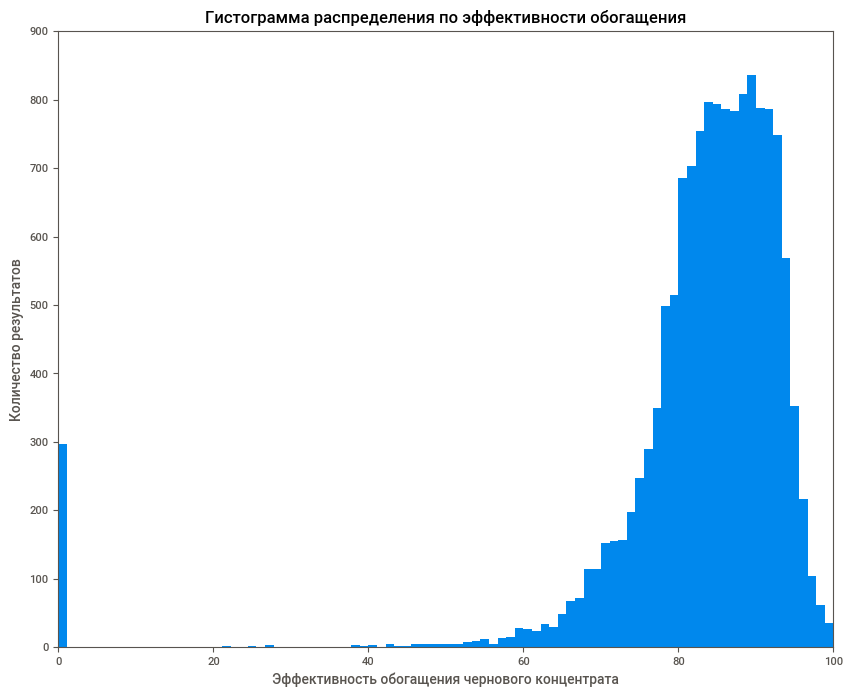

In [14]:
plt.figure(figsize=[10,8])

plt.hist(df_train['rougher.output.recovery'], bins=90)

plt.xlim([0, 100])
plt.ylim([0, 900])

plt.xlabel('Эффективность обогащения чернового концентрата')
plt.ylabel('Количество результатов')

plt.title('Гистограмма распределения по эффективности обогащения')
plt.show()

На гистограмме видим довольно много нулевых значений, уберем их.

In [15]:
df_train[df_train['rougher.output.recovery'] == 0].head()

,final.output.concentrate_ag,final.output.concentrate_pb,final.output.concentrate_sol,final.output.concentrate_au,final.output.recovery,final.output.tail_ag,final.output.tail_pb,final.output.tail_sol,final.output.tail_au,primary_cleaner.input.sulfate,...,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level
date,,,,,,,,,,,,,,,,,,,,,
2016-01-16 21:00:00,4.566664,10.406178,4.588698,46.614456,68.403877,10.705777,1.509070,17.875134,2.509776,131.251366,...,14.025588,-550.404242,12.028925,-550.570104,10.052072,-500.797905,7.984500,-499.581046,11.982025,-599.161228
2016-01-16 22:00:00,4.577832,10.691605,5.274175,46.250638,70.675633,10.728531,1.641216,18.349339,2.540843,141.184039,...,14.094808,-550.676337,12.004728,-550.496522,9.953139,-500.330920,8.012074,-500.133530,11.975316,-598.839683
2016-01-16 23:00:00,4.591462,10.628846,5.688961,46.663335,55.088448,10.694584,1.671644,17.910312,2.686782,126.397495,...,13.997488,-551.224653,11.971272,-550.095619,9.981163,-502.869109,7.941184,-500.623610,12.018837,-600.916665
2016-01-17 00:00:00,5.296830,10.597469,5.688961,44.015642,41.962008,11.975654,1.846558,8.138408,2.889469,69.411904,...,14.006476,-549.388727,11.975967,-550.778624,9.989726,-499.607365,7.958252,-498.882560,11.967977,-599.440603
2016-01-17 02:00:00,8.162896,8.877528,5.688961,40.715973,49.884856,10.381465,1.024030,12.974257,2.739224,116.517762,...,13.984906,-550.563329,11.999730,-550.549773,9.941869,-503.282068,8.018850,-500.970716,11.991078,-598.475929


In [16]:
df_train = df_train[df_train['rougher.output.recovery'] != 0]

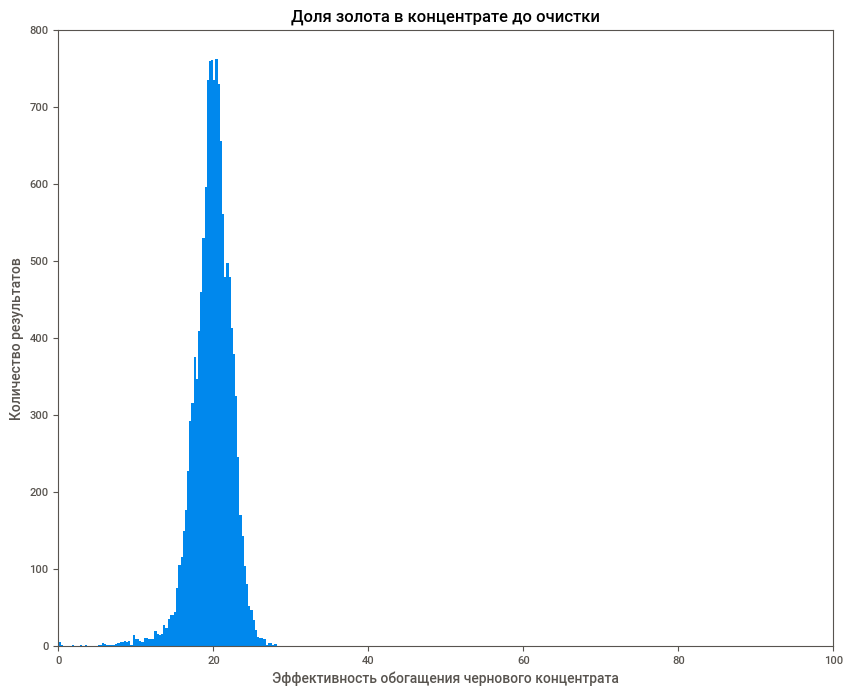

In [17]:
plt.figure(figsize=[10,8])

plt.hist(df_train['rougher.output.concentrate_au'], bins=100)

plt.xlim([0, 100])
plt.ylim([0, 800])

plt.xlabel('Эффективность обогащения чернового концентрата')
plt.ylabel('Количество результатов')

plt.title('Доля золота в концентрате до очистки')
plt.show()

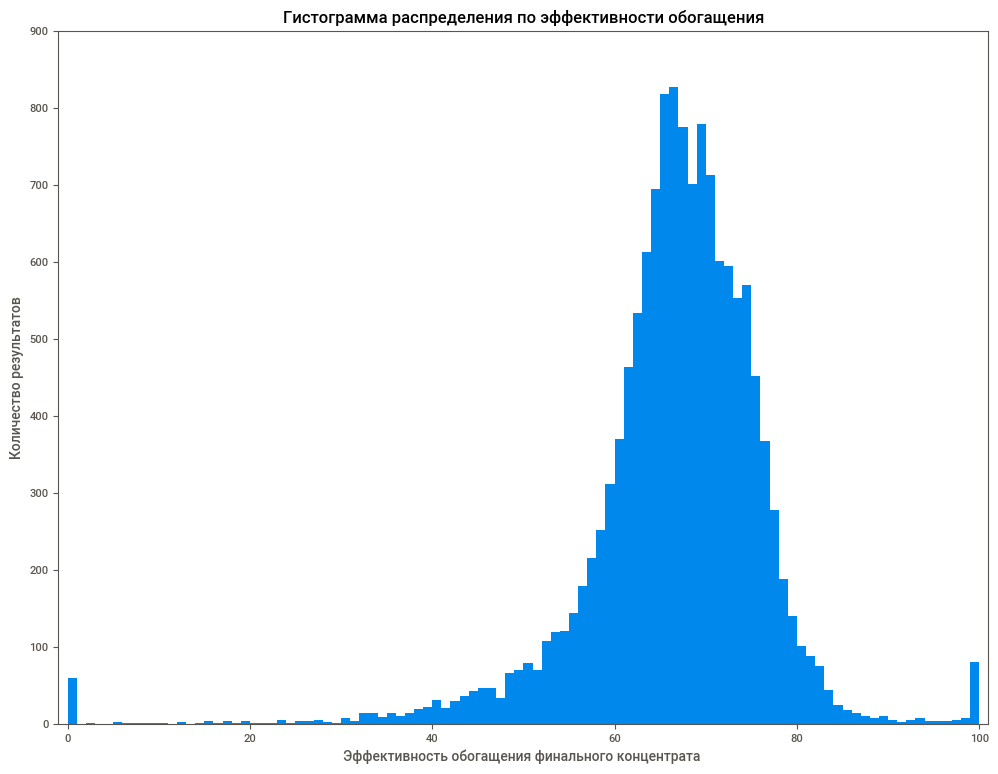

In [18]:
plt.figure(figsize=[12,9])

plt.hist(df_train['final.output.recovery'], bins=100)

plt.xlim([-1, 101])
plt.ylim([0, 900])

plt.xlabel("Эффективность обогащения финального концентрата ")
plt.ylabel("Количество результатов")

plt.title("Гистограмма распределения по эффективности обогащения")
plt.show()

In [19]:
df_train = df_train[df_train['final.output.recovery'] != 0]

**Вывод:**

Подготовка данных проведена. Были изучены данные, проверена эффективность обогащения, а так же добавлены целевые столбцы в тестовые данные. Рассмотрены гистограммы ключевых столбцов и убраны нулевые значения.

## Анализ данных

### Изменение концентрации металлов (Au, Ag, Pb) на различных этапах очистки.

На диаграммах рассмотрим концентрации золота, серебра и меди на этапах флотации, первичной и вторичной очистки.

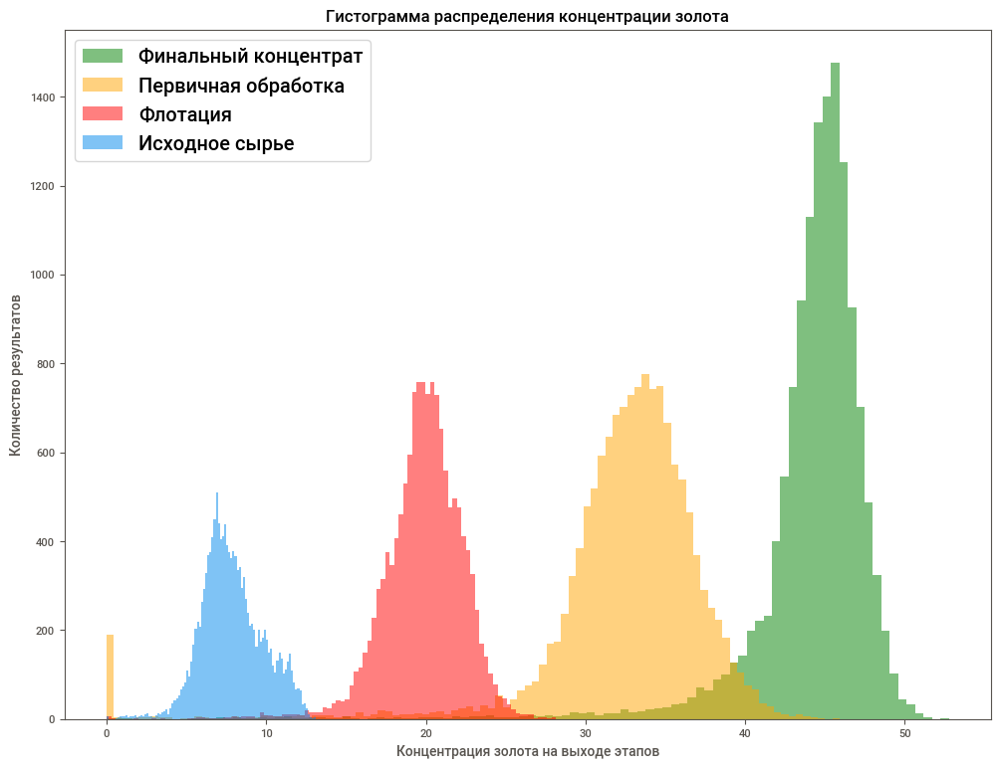

In [20]:
plt.figure(figsize=[12,9])

plt.hist(df_train['final.output.concentrate_au'], bins=100, label = 'Финальный концентрат', alpha=.5, color='green')
plt.hist(df_train['primary_cleaner.output.concentrate_au'], bins=100, label = 'Первичная обработка', alpha=.5, color='orange')
plt.hist(df_train['rougher.output.concentrate_au'], bins=100, label = 'Флотация', alpha=.5, color='red')
plt.hist(df_train['rougher.input.feed_au'], bins=100, label = 'Исходное сырье', alpha=.5)

plt.xlabel('Концентрация золота на выходе этапов')
plt.ylabel('Количество результатов')

plt.legend(fontsize='x-large')

plt.title('Гистограмма распределения концентрации золота')
plt.show()

Флотация - это метод обогащения полезных ископаемых. В данном случае обогащается золото, и с каждым этапом концентрация золота растет.

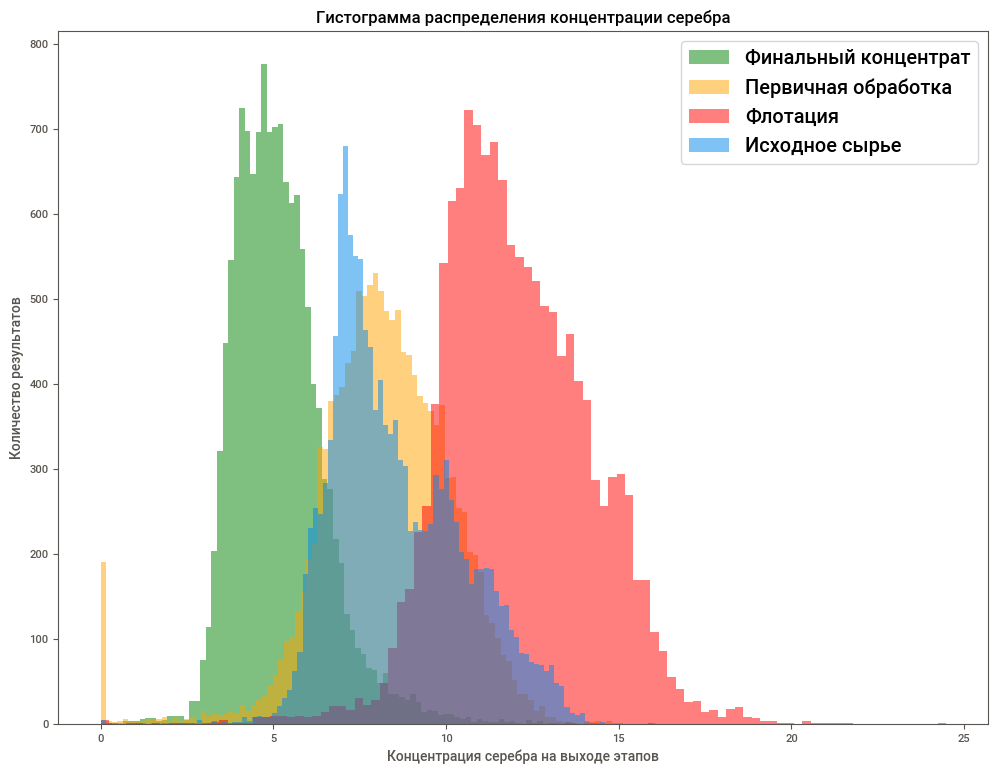

In [21]:
plt.figure(figsize=[12,9])

plt.hist(df_train['final.output.concentrate_ag'], bins=100, label = 'Финальный концентрат', alpha=.5, color='green')
plt.hist(df_train['primary_cleaner.output.concentrate_ag'], bins=100, label = 'Первичная обработка', alpha=.5, color='orange')
plt.hist(df_train['rougher.output.concentrate_ag'], bins=100, label = 'Флотация', alpha=.5, color='red')
plt.hist(df_train['rougher.input.feed_ag'], bins=100, label = 'Исходное сырье', alpha=.5)

plt.xlabel('Концентрация серебра на выходе этапов')
plt.ylabel('Количество результатов')

plt.legend(loc='upper right', fontsize='x-large')

plt.title('Гистограмма распределения концентрации серебра')
plt.show()

За счет флотации так же обогащается серебро, но с дополнительными этапами отчистки концентрация серебра падает.

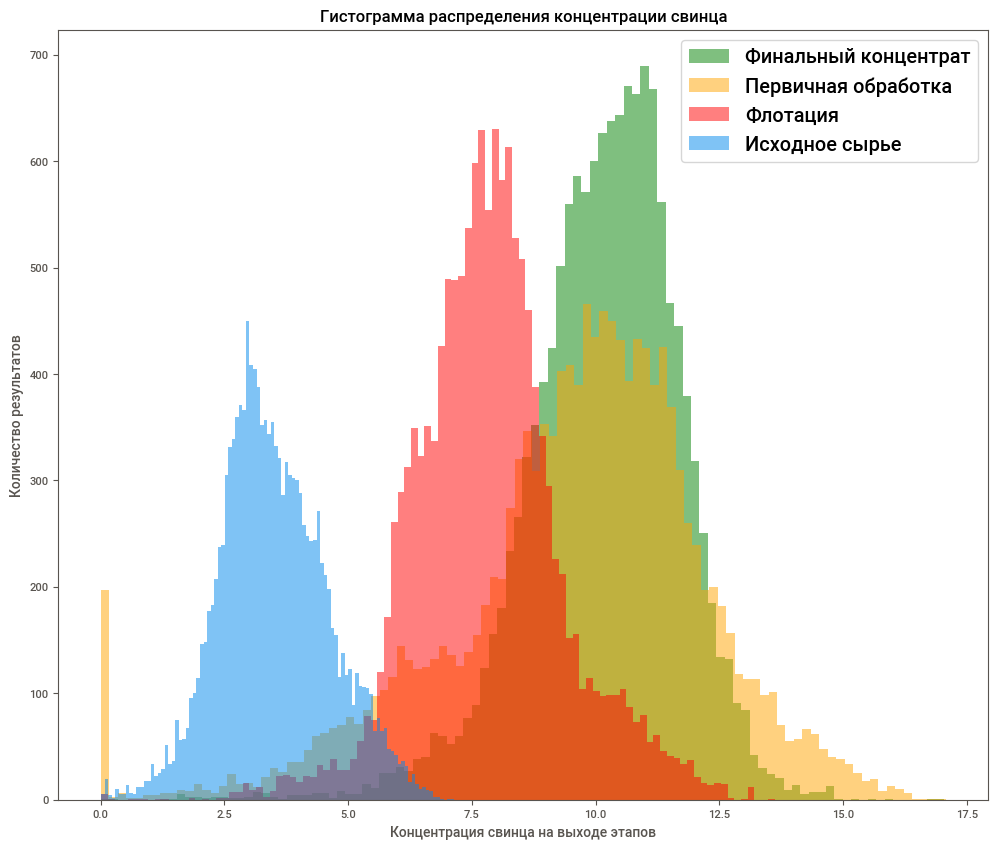

In [22]:
plt.figure(figsize=[12,10])

plt.hist(df_train['final.output.concentrate_pb'], bins=100, label = 'Финальный концентрат', alpha=.5, color='green')
plt.hist(df_train['primary_cleaner.output.concentrate_pb'], bins=100, label = 'Первичная обработка', alpha=.5, color='orange')
plt.hist(df_train['rougher.output.concentrate_pb'], bins=100, label = 'Флотация', alpha=.5, color='red')
plt.hist(df_train['rougher.input.feed_pb'], bins=100, label = 'Исходное сырье', alpha=.5)


plt.xlabel('Концентрация свинца на выходе этапов')
plt.ylabel('Количество результатов')

plt.legend(fontsize='x-large')

plt.title('Гистограмма распределения концентрации свинца')
plt.show()

По ходу технологического процесса концентрация свинца так же растет, но не значительно сильно, по сравнению с золотом.

### Распределения размеров гранул сырья на обучающей и тестовой выборках

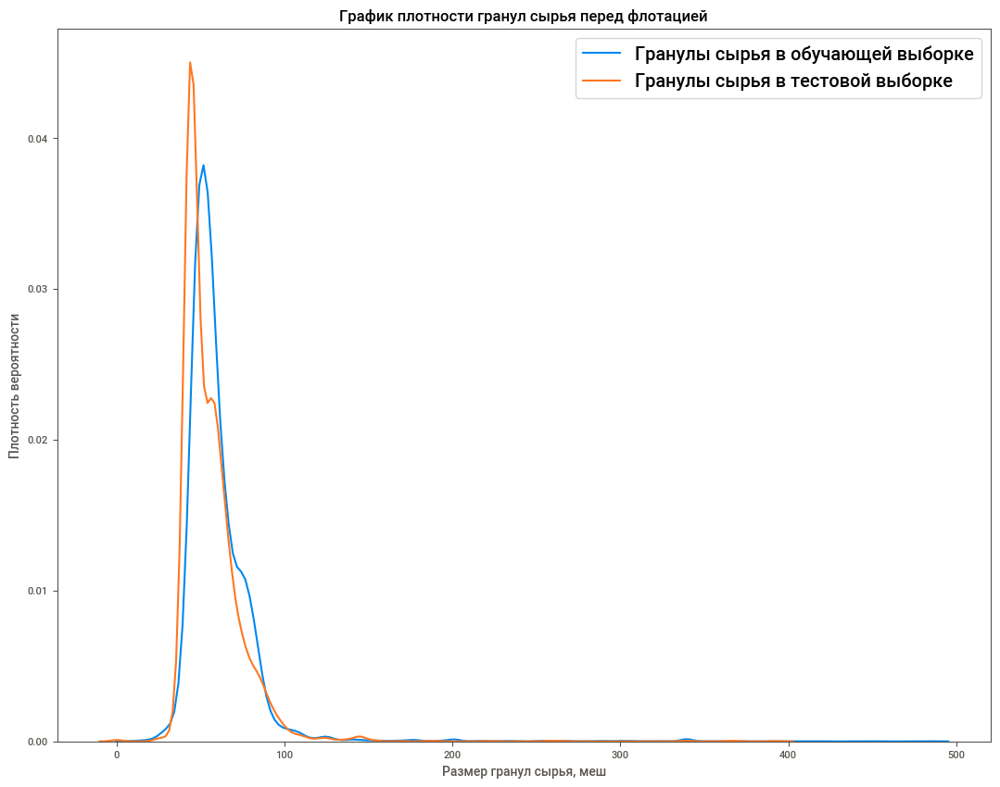

In [23]:
plt.figure(figsize=[13,10])

sns.kdeplot(df_train['rougher.input.feed_size'], label = 'Гранулы сырья в обучающей выборке')
sns.kdeplot(df_test['rougher.input.feed_size'], label = 'Гранулы сырья в тестовой выборке')

plt.xlabel('Размер гранул сырья, меш')
plt.ylabel('Плотность вероятности')

plt.legend(loc='upper right', fontsize='x-large')

plt.title('График плотности гранул сырья перед флотацией')
plt.show()

В целом нормальное распределение со небольшим смещением влево гранул сырья в тестовой выборке.

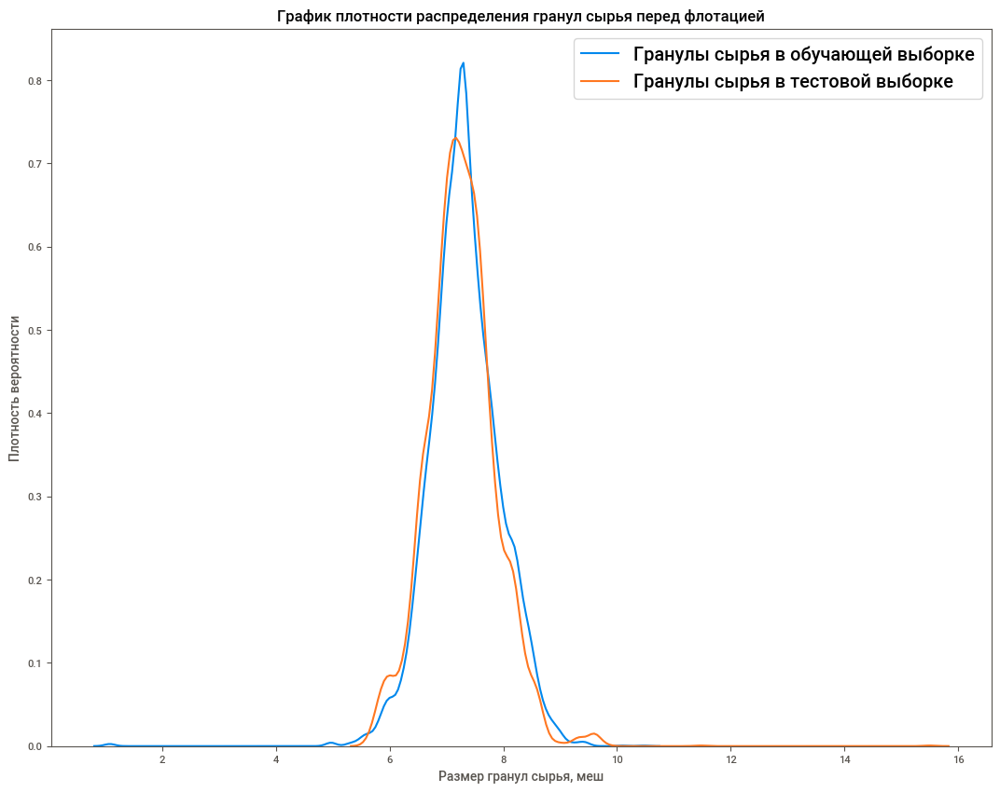

In [24]:
plt.figure(figsize=[13,10])

sns.kdeplot(df_train['primary_cleaner.input.feed_size'], label = 'Гранулы сырья в обучающей выборке')
sns.kdeplot(df_test['primary_cleaner.input.feed_size'], label = 'Гранулы сырья в тестовой выборке')

plt.xlabel('Размер гранул сырья, меш')
plt.ylabel('Плотность вероятности')

plt.legend(loc='upper right', fontsize='x-large')

plt.title('График плотности распределения гранул сырья перед флотацией')
plt.show()

В целом нормальное распределение, размер нормализовался.

### Суммарная концентрация всех веществ на разных стадиях: в сырье, в черновом и финальном концентратах.

In [25]:
final_output_concentrate_sum = (df_train['final.output.concentrate_au'] + 
                                df_train['final.output.concentrate_ag'] + 
                                df_train['final.output.concentrate_pb'] +
                                df_train['final.output.concentrate_sol'])

primary_cleaner_output_concentrate_sum = (df_train['primary_cleaner.output.concentrate_au'] + 
                                          df_train['primary_cleaner.output.concentrate_ag'] + 
                                          df_train['primary_cleaner.output.concentrate_pb'] +
                                          df_train['primary_cleaner.output.concentrate_sol'])

rougher_output_concentrate_sum = (df_train['rougher.output.concentrate_au'] + 
                                  df_train['rougher.output.concentrate_ag'] + 
                                  df_train['rougher.output.concentrate_pb'] +
                                  df_train['rougher.output.concentrate_sol'])

rougher_input_concentrate_sum = (df_train['rougher.input.feed_au'] + 
                               df_train['rougher.input.feed_ag'] + 
                               df_train['rougher.input.feed_pb'] +
                               df_train['rougher.input.feed_sol'])

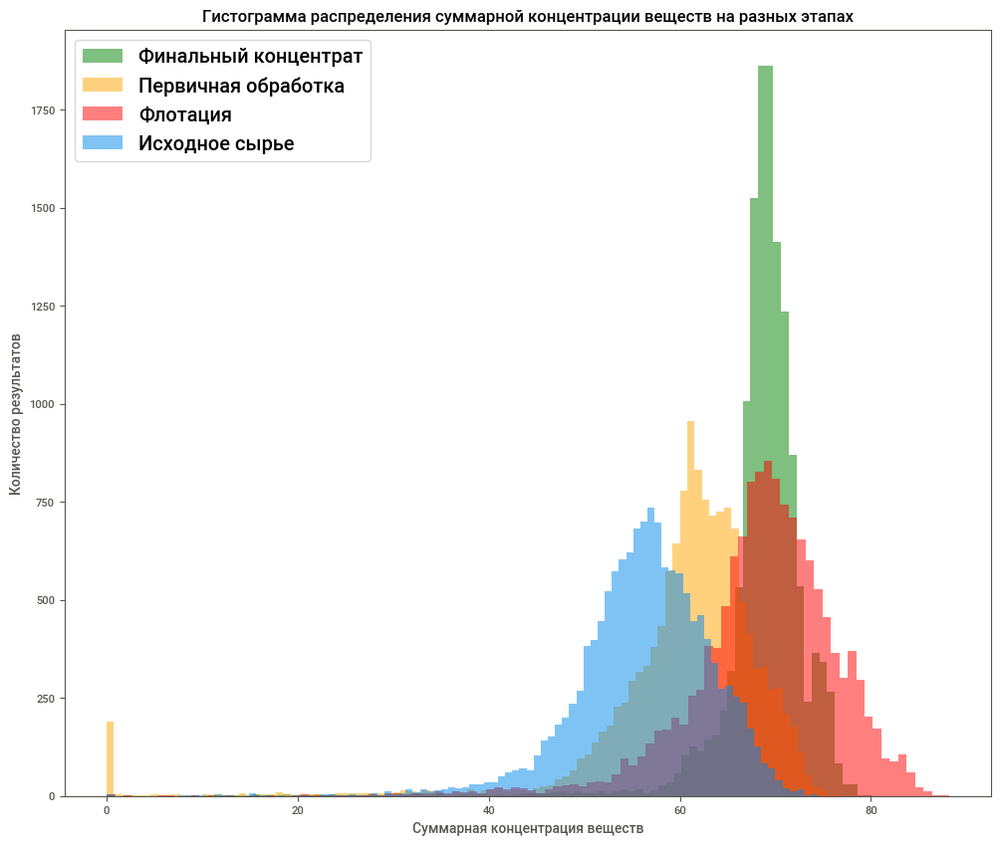

In [26]:
plt.figure(figsize=[12,10])

plt.hist(final_output_concentrate_sum, bins=100, label = 'Финальный концентрат', alpha=.5, color='green')
plt.hist(primary_cleaner_output_concentrate_sum, bins=100, label = 'Первичная обработка', alpha=.5, color='orange')
plt.hist(rougher_output_concentrate_sum, bins=100, label = 'Флотация', alpha=.5, color='red')
plt.hist(rougher_input_concentrate_sum, bins=100, label = 'Исходное сырье', alpha=.5)


plt.xlabel('Суммарная концентрация веществ')
plt.ylabel('Количество результатов')

plt.legend(fontsize='x-large')

plt.title('Гистограмма распределения суммарной концентрации веществ на разных этапах')
plt.show()

Присутствуют нулевые значения. Возможно, это аномалии и они помещают при создании модели. Удалим эти нулевые значения золота после первого этапа обработки.

In [27]:
df_train[df_train['primary_cleaner.output.concentrate_au'] == 0]['primary_cleaner.output.concentrate_au'].count()

70

In [28]:
df_train = df_train[df_train['primary_cleaner.output.concentrate_au']!= 0]

**Вывод:**

Анализ данных проведен, данные подкорректированы для лучшего обучения моделей, можно приступать к созданию модели.


## Модель

### Функция для вычисления итоговой sMAPE

Напишем функцию метрики качества — sMAPE (англ. Symmetric Mean Absolute Percentage Error, «симметричное среднее абсолютное процентное отклонение») для вычисления качества предсказания модели.

In [29]:
def smape(features_y, target_y):
    smape = (1/len(features_y))*sum(abs(features_y-target_y)/((abs(features_y)+abs(target_y))/2))*100
    return smape

In [30]:
def total_smape(smape_rougher, smape_final):
    total = (0.25 * smape_rougher) + (0.75 * smape_final)
    return print(f'Итоговое sMAPE: {total:.3f}')

### Обучение разных моделей и оценка их качества кросс-валидацией

Перед обучением моделей, удалим из обучающей выборки те столбцы, которые отсутствуют в тестовой выборке, т.к. они помещают вычислениям на тестовой выборке.

In [31]:
list_train = []

for i in list(df_train):
    if i not in list(df_test):
        list_train.append(i)
        
df_train_ml = df_train.drop(list_train, axis=1)

In [32]:
df_train_ml.shape

(13725, 54)

In [33]:
df_test.shape

(5290, 54)

Отделим целевые признаки из выборок. В данной задаче необходимо спрогнозировать два целевых признака: `rougher.output.recovery` и `final.output.recovery`.

In [34]:
train_features = df_train_ml.drop(['rougher.output.recovery', 'final.output.recovery'], axis=1)
train_target_rougher_rec = df_train_ml['rougher.output.recovery']
train_target_final_rec = df_train_ml['final.output.recovery']

print(f'Признаки из обучающей выборки:{train_features.shape}')
print(f'Целевой признак rougher.output.recovery из обучающей выборки:{train_target_rougher_rec.shape}')
print(f'Целевой признак final.output.recovery из обучающей выборки:{train_target_final_rec.shape}')
print()

test_features = df_test.drop(['rougher.output.recovery', 'final.output.recovery'], axis=1)
test_target_rougher_rec = df_test['rougher.output.recovery']
test_target_final_rec = df_test['final.output.recovery']

print(f'Признаки из тестовой выборки:{test_features.shape}')
print(f'Целевой признак rougher.output.recovery из тестовой выборки:{test_target_rougher_rec.shape}')
print(f'Целевой признак final.output.recovery из тестовой выборки:{test_target_final_rec.shape}')

Признаки из обучающей выборки:(13725, 52)
Целевой признак rougher.output.recovery из обучающей выборки:(13725,)
Целевой признак final.output.recovery из обучающей выборки:(13725,)

Признаки из тестовой выборки:(5290, 52)
Целевой признак rougher.output.recovery из тестовой выборки:(5290,)
Целевой признак final.output.recovery из тестовой выборки:(5290,)


Используем функцию sMAPE для вычисления кросс-валидации моделей.

In [35]:
make_scorer = make_scorer(smape)

Создадим функции для построения моделей машинного обучения.

Функция для построения модели линейной регрессии.

In [ ]:
def linear_regression(features, target):
    model = LinearRegression()
    score = cross_val_score(model, features, target, cv=5, scoring=make_scorer)
    final_score = score.mean()
    return print(f'Результаты линейной регрессии: sMAPE = {final_score:.3f}')

Функция для построения модели дерева решений.

In [37]:
def decision_tree_regressor(features, target):
    best_score = 10
    best_depth = 0
    best_split = 0
    best_leaf = 0
    best_features = 0

    for depth in range(1,5):
        for featur in range(4,11):
            for samples_leaf in range(1,5):
                for samples_split in range(2,6,2):
                    model = DecisionTreeRegressor(max_depth=depth, min_samples_split=samples_split,
                                                  min_samples_leaf=samples_leaf, max_features=featur, random_state=12345)
                    score = cross_val_score(model, features, target, cv=5, scoring=make_scorer)
                    final_score = score.mean()
                    if final_score < best_score:
                        best_score = final_score
                        best_depth = depth
                        best_features = featur      
                        best_leaf = samples_leaf
                        best_split = samples_split

    return print(f'Результаты дерева решений:\n'
                 f'sMAPE: {best_score:.3f};\n'
                 f'max_depth: {best_depth};\n'
                 f'min_samples_split: {best_split};\n'
                 f'min_samples_leaf: {best_leaf};\n'
                 f'max_features: {best_features}.\n')

Функция для построения модели случайного леса.

In [38]:
def random_forest_regressor(features, target):
    best_score = 10
    best_depth = 0
    best_est = 0
    best_split = 0
    best_leaf = 0
    best_features = 0

    for depth in range(5,11):
        for est in range(80,100,10):
            for featur in range(2,6,2):
                for samples_leaf in range(2,6,2):
                    for samples_split in range(2,6,2):
                        model = RandomForestRegressor(max_depth=depth, min_samples_split=samples_split, n_estimators=est,
                                                      min_samples_leaf=samples_leaf, max_features=featur, random_state=12345)
                        score = cross_val_score(model, features, target, cv=5, scoring=make_scorer)
                        final_score = score.mean()
                        if final_score < best_score:
                            best_score = final_score
                            best_depth = depth
                            best_est = est
                            best_features = featur      
                            best_leaf = samples_leaf
                            best_split = samples_split

    print(f'Результаты случайного леса:\n'
          f'sMAPE: {best_score:.3f};\n'
          f'max_depth: {best_depth};\n'
          f'n_estimators: {best_est};\n'
          f'min_samples_split: {best_split};\n'
          f'min_samples_leaf: {best_leaf};\n'
          f'max_features: {best_features}.\n')

#### Подбор лучшей модели

**Линейная регрессия**

In [39]:
linear_regression(train_features, train_target_rougher_rec)

Результаты линейной регресии: sMAPE = 7.266


In [40]:
linear_regression(train_features, train_target_final_rec)

Результаты линейной регресии: sMAPE = 10.951


In [41]:
total_smape(7.266, 10.951)

Итоговое sMAPE: 10.030


**Дерево решений**

In [42]:
decision_tree_regressor(train_features, train_target_rougher_rec)

Результаты дерева решений:
sMAPE: 6.411;
max_depth: 3;
min_samples_split: 2;
min_samples_leaf: 1;
max_features: 7.



In [43]:
decision_tree_regressor(train_features, train_target_final_rec)

Результаты дерева решений:
sMAPE: 9.819;
max_depth: 4;
min_samples_split: 2;
min_samples_leaf: 3;
max_features: 9.



In [44]:
total_smape(6.411, 9.819)

Итоговое sMAPE: 8.967


**Случайный лес**

In [45]:
random_forest_regressor(train_features, train_target_rougher_rec)

Результаты случайного леса:
sMAPE: 5.973;
max_depth: 7;
n_estimators: 80;
min_samples_split: 2;
min_samples_leaf: 4;
max_features: 4.



In [46]:
random_forest_regressor(train_features, train_target_final_rec)

Результаты случайного леса:
sMAPE: 9.060;
max_depth: 9;
n_estimators: 80;
min_samples_split: 2;
min_samples_leaf: 4;
max_features: 4.



In [47]:
total_smape(5.973, 9.060)

Итоговое sMAPE: 8.288


**Наивная модель**

In [48]:
model = DummyRegressor()
score = cross_val_score(model, train_features, train_target_rougher_rec, cv=5, scoring=make_scorer)
final_score = score.mean()
print(f'sMAPE после флотации: {final_score:.3f}')

sMAPE после флотации: 7.804


In [49]:
model = DummyRegressor()
score = cross_val_score(model, train_features, train_target_final_rec, cv=5, scoring=make_scorer)
final_score = score.mean()
print(f'sMAPE после всей очистки: {final_score:.3f}')

sMAPE после всей очистки: 10.413


In [50]:
total_smape(7.804, 10.413)

Итоговое sMAPE: 9.761


In [51]:
table_res = pd.DataFrame(index=['Наивная модель',
                                'Модель линейной регрессии',
                                'Модель дерева решений',
                                'Модель случайного леса'], 
                                columns=['sMAPE после флотации','sMAPE после всей очистки','Итоговое sMAPE'])
                         
table_res['sMAPE после флотации'] = '7.804','7.266','6.411','5.973'
table_res['sMAPE после всей очистки'] = '10.413','10.951','9.819','9.060'
table_res['Итоговое sMAPE'] = '9.761','10.03','8.967','8.288'
table_res

,sMAPE после флотации,sMAPE после всей очистки,Итоговое sMAPE
Наивная модель,7.804,10.413,9.761
Модель линейной регрессии,7.266,10.951,10.03
Модель дерева решений,6.411,9.819,8.967
Модель случайного леса,5.973,9.060,8.288


Лучшей моделью является модель случайного леса. Проверим ее качество на тестовой выборке.

In [52]:
model = RandomForestRegressor(max_depth=7, min_samples_split=2, n_estimators=80,
                              min_samples_leaf=4, max_features=4, random_state=12345)
model.fit(train_features, train_target_rougher_rec)
prediction = model.predict(test_features)
final_score_target_rougher_rec = smape(test_target_rougher_rec, prediction)
print(f'sMAPE после флотации: {final_score_target_rougher_rec:.3f}')

sMAPE после флотации: 8.412


In [53]:
model = RandomForestRegressor(max_depth=9, min_samples_split=2, n_estimators=80,
                              min_samples_leaf=4, max_features=4, random_state=12345)
model.fit(train_features, train_target_final_rec)
prediction = model.predict(test_features)
final_score_target_final_rec = smape(test_target_final_rec, prediction)
print(f'sMAPE после всей очистки: {final_score_target_final_rec:.3f}')

sMAPE после всей очистки: 9.265


In [54]:
total_smape(final_score_target_rougher_rec, final_score_target_final_rec)

Итоговое sMAPE: 9.052


**Вывод:**

В результате обучения разных моделей была выбрана лучшая модель с меньшим значением sMAPE - модель случайного леса.

Значения на обучающей выборке:
- sMAPE после флотации - 5.973
- sMAPE после всей очистки - 9.060
- Итоговое sMAPE - 8.288

Значения на тестовой выборке:
- sMAPE после флотации - 8.412
- sMAPE после всей очистки - 9.265
- Итоговое sMAPE - 9.052

## Общий вывод

Был подготовлен прототип модели машинного обучения для предсказания коэффициента восстановления золота из золотосодержащей руды. Результат поможет оптимизировать производство, чтобы не запускать предприятие с убыточными характеристиками.

В распоряжении были данные с параметрами добычи и очистки золотосодержащей руды.

В ходе подготовки прототипа были осуществлены следующие шаги:

- Изучение и подготовка данных, проверка эффективности обогащения чернового концентрата. 

    - Подготовка данных была успешно проведена. 
    
    - Были изучены данные, проверена эффективность обогащения, чья средняя абсолютная ошибка оказалась близка к нулю, что означает, что эффективность обогащения по данным  верная.
    
    - Добавлены целевые столбцы в тестовые данные.
    
    - Рассмотрены гистограммы ключевых столбцов и убраны нулевые значения.
    
- Анализ данных.

    - Рассмотрены концентрации металлов (Au, Ag, Pb) на различных этапах очистки:
    
        - С каждым этапом очистки концентрация золота растет.
        
        - За счет флотации серебро обольщается, но с дополнительными этапами отчистки концентрация серебра падает.
        
        - По ходу технологического процесса концентрация свинца растет, но не в больших объемах, по сравнению с золотом.
        
    - Рассмотрены распределения размеров гранул сырья на обучающей и тестовой выборках. На выборках в целом нормальное и схожее распределение.
    
    - Рассмотрена суммарная концентрация всех веществ на разных стадиях: в сырье, в черновом и финальном концентратах. Была построена гистограмма распределения суммарной концентрации веществ на разных этапах для сравнения.
     
     
- Построение модели.    
    - Была написана функция для вычисления sMAPE.
    - Рассмотрены и обучены разные модели машинного обучения:   
        - Модель линейной регрессии;
        - Модель дерева решений;
        - Модель случайного леса.        
    - Модель случайного леса была выбрана как лучшая со следующими значениями sMAPE:    
        - Значения на обучающей выборке:
            - sMAPE после флотации - 5.973
            - sMAPE после всей очистки - 9.060
            - Итоговое sMAPE - **8.288**
        - Значения на тестовой выборке:
            - sMAPE после флотации - 8.412
            - sMAPE после всей очистки - 9.265
            - Итоговое sMAPE - **9.052**